In [8]:
import folium

In [62]:
m = folium.Map(location=[-65.8454559687301, 53.8146114973664],zoom_start=13)
m

In [1]:
import ee
ee.Initialize()

In [63]:
xis = m.get_bounds()
print(xis)

[[None, None], [None, None]]


In [2]:
#  * Function to mask clouds using the Sentinel-2 QA band
#  * @param {ee.Image} image Sentinel-2 image
#  * @return {ee.Image} cloud masked Sentinel-2 image
#  */
def maskS2clouds(image):
    qa=image.select('QA60')

#   // Bits 10 and 11 are clouds and cirrus, respectively.
    cloudBitMask = 1 << 10
  
    cirrusBitMask = 1 << 11

#   // Both flags should be set to zero, indicating clear conditions.
    mask = qa.bitwiseAnd(cloudBitMask).eq(0).And(
        qa.bitwiseAnd(cirrusBitMask).eq(0))

    return image.updateMask(mask).divide(10000)

In [3]:
dataset = ee.ImageCollection('COPERNICUS/S2_SR').filterDate('2019-01-01', '2019-12-31').filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 20)).filterBounds(ee.Geometry.Rectangle([53.7641581278945, -65.8316628661748, 53.8650648668384, -65.8592490712855])).map(maskS2clouds)

In [4]:
mapIdDict = dataset.median().getMapId({'bands': ['B4', 'B3', 'B2'], 'min': 0.1, 'max': 1.3})

In [40]:
# folium.TileLayer(
#     tiles=mapIdDict['tile_fetcher'].url_format,
#     attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
#     overlay=True,
#     name='median composite',
#   ).add_to(m)
from folium.raster_layers import ImageOverlay
ImageOverlay(
    name='raw satellite',
    image=raw_lyr,
    bounds=[[53.7641581278945, -65.8316628661748], [53.8650648668384, -65.8592490712855]], ## same bounds
    opacity=1,
).add_to(m)

In [41]:
m.add_child(folium.LayerControl())
m

In [70]:
import cv2

In [71]:
im1 = cv2.imread("capebatterbeegt.png")

In [72]:
import matplotlib.pyplot as plt

In [73]:
%matplotlib inline

In [74]:
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)

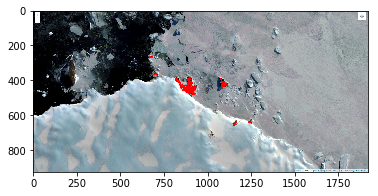

In [75]:
plt.imshow(im1)

In [19]:
!pip install GDAL-3.0.3-cp38-cp38-win_amd64.whl

GDAL-3.0.3-cp38-cp38-win_amd64.whl is not a supported wheel on this platform.


In [5]:
import gdal

In [6]:
from osgeo import gdal

In [7]:
raw_lyr = ('capebatterbeegt.png')

In [8]:
ds = gdal.Open(raw_lyr)
if ds is None:
    print('Could not open')

#cols and rows
geotransform = ds.GetGeoTransform()
cols = ds.RasterXSize
rows = ds.RasterYSize

#Get the extent
xmin=geotransform[0]
ymax=geotransform[3]
xmax=xmin+cols*geotransform[1]
ymin=ymax+rows*geotransform[5]

In [9]:
bounds = [[ymin, xmin], [ymax, xmax]]
print (bounds)

[[925.0, 0.0], [0.0, 1920.0]]


In [44]:
import folium
from folium.raster_layers import ImageOverlay
m = folium.Map([-65.8454559687301, 53.8146114973664], zoom_start=13, tiles='stamenterrain')
## add the raw satellite image below it
# folium.raster_layers.ImageOverlay(
#     name='raw satellite',
#     image=im1,
#     bounds=[[ymin, xmin], [ymax, xmax]], ## same bounds
#     opacity=1,
# ).add_to(m)

ImageOverlay(
    name='raw satellite',
    image=raw_lyr,
    bounds=[[-65.87803251, 53.64978034], [-65.81287943, 53.97944266]], ## same bounds
    opacity=0.5,
).add_to(m)

folium.TileLayer(
    tiles=mapIdDict['tile_fetcher'].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
    overlay=True,
    name='median composite',
  ).add_to(m)

folium.LayerControl().add_to(m) ## add to the control
m
xis = m.get_bounds()
print(xis)
m

[[-65.87803251, 53.64978034], [-65.81287943, 53.97944266]]


In [21]:
m.get_bounds()

[[None, None], [None, None]]

In [109]:
from folium.raster_layers import ImageOverlay
ImageOverlay(
    name='raw satellite',
    image=raw_lyr,
    bounds=[[-65.85924907, 53.76415813], [-65.83166287, 53.86506487]], ## same bounds
    opacity=1,
).add_to(m)

In [110]:
m.add_child(folium.LayerControl())
m

In [65]:
import folium

In [67]:
from folium.raster_layers import ImageOverlay

In [68]:
import os

In [69]:
from osgeo import gdal

In [79]:
im1.shape

(925, 1920, 3)

In [80]:
edges = cv2.Canny(im1,im1.shape[0],im1.shape[1])

In [81]:
edges = cv2.imwrite('edge.png',edges)

In [82]:
edge_lyr = ('edge.png')
raw_lyr = ('capebatterbeegt.png')

In [83]:
ds = gdal.Open(raw_lyr)

In [84]:
if ds is None:
    print('could not open')

In [85]:
geotransform = ds.GetGeoTransform()

In [86]:
cols = ds.RasterXSize

In [87]:
rows = ds.RasterYSize

In [88]:
xmin = geotransform[0]
ymax = geotransform[3]
xmax = xmin+cols*geotransform[1]
ymin = ymax+rows*geotransform[5]

In [99]:
m = folium.Map([-65.8454559687301, 53.8146114973664], zoom_start=8, tiles='stamenterrain')

bounds = [[ymin, xmin], [ymax, xmax]]
print (bounds)

# ## add my edge detection layer
# folium.raster_layers.ImageOverlay(
#     name='My edge detection layer',
#     image=edge_lyr,
#     bounds=[[ymin, xmin], [ymax, xmax]], ## se above
#     opacity=1,
# ).add_to(m)


## add the raw satellite image below it
folium.raster_layers.ImageOverlay(
    name='raw satellite',
    image=raw_lyr,
    bounds=[[ymin-700, 45], [ymax, xmax-700]],### its the same image dimensions... be careful
    opacity=1,
).add_to(m)

folium.LayerControl().add_to(m)

[[925.0, 0.0], [0.0, 1920.0]]


In [100]:
m

In [ ]:
import folium
from folium.raster_layers import ImageOverlay
m = folium.Map([-65.8454559687301, 53.8146114973664], zoom_start=13, tiles='stamenterrain')
## add the raw satellite image below it
# folium.raster_layers.ImageOverlay(
#     name='raw satellite',
#     image=im1,
#     bounds=[[ymin, xmin], [ymax, xmax]], ## same bounds
#     opacity=1,
# ).add_to(m)

ImageOverlay(
    name='raw satellite',
    image=raw_lyr,
    bounds=[[-65.87803251, 53.64978034], [-65.81287943, 53.97944266]], ## same bounds
    opacity=0.5,
).add_to(m)

folium.TileLayer(
    tiles=mapIdDict['tile_fetcher'].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
    overlay=True,
    name='median composite',
  ).add_to(m)

folium.LayerControl().add_to(m) ## add to the control
m
xis = m.get_bounds()
print(xis)
m

In [60]:
import cv2
import math
tile = 256
img = cv2.imread('capebatterbeegt.png')
stri = 'capebatterbeegt'
# img_height = img.shape[1]
# img_width = img.shape[0]
# number_of_vertical_tiles = img_height // tile
# number_of_horizontal_tiles = img_width // tile
# cropped_img = img[:tile*number_of_vertical_tiles, :tile*number_of_horizontal_tiles,:]
# tiled_img = img.reshape(-1, tile, tile, 3)

img_shape = img.shape
tile_size = (256, 256)
offset = (256, 256)
for i in range(int(math.ceil(img_shape[0]/(offset[1] * 1.0)))):
    for j in range(int(math.ceil(img_shape[1]/(offset[0] * 1.0)))):
        cropped_img = img[offset[1]*i:min(offset[1]*i+tile_size[1], img_shape[0]), offset[0]*j:min(offset[0]*j+tile_size[0], img_shape[1])]
        # Debugging the tiles
        print(cropped_img.shape)
        cv2.imwrite(stri + '_' + str(i) + "_" + str(j) + ".png", cropped_img)
#         cv2.imwrite("debug_" + str(i) + "_" + str(j) + ".png", cropped_img)

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 128, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 128, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 128, 3)
(157, 256, 3)
(157, 256, 3)
(157, 256, 3)
(157, 256, 3)
(157, 256, 3)
(157, 256, 3)
(157, 256, 3)
(157, 128, 3)
